In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.figure_factory as ff

# Data Cleaning and Preprocessing

In [2]:
df = pd.read_csv('GlobalWeatherRepository.csv')

# Display basic information about the dataset
print("Dataset Info:")
print("-" * 50)
df.info()



Dataset Info:
--------------------------------------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 58270 entries, 0 to 58269
Data columns (total 41 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   country                       58270 non-null  object 
 1   location_name                 58270 non-null  object 
 2   latitude                      58270 non-null  float64
 3   longitude                     58270 non-null  float64
 4   timezone                      58270 non-null  object 
 5   last_updated_epoch            58270 non-null  int64  
 6   last_updated                  58270 non-null  object 
 7   temperature_celsius           58270 non-null  float64
 8   temperature_fahrenheit        58270 non-null  float64
 9   condition_text                58270 non-null  object 
 10  wind_mph                      58270 non-null  float64
 11  wind_kph                      58270 non-null  float64


In [3]:
print("\nFirst few rows of the dataset:")
print("-" * 50)
display(df.head())




First few rows of the dataset:
--------------------------------------------------


,country,location_name,latitude,longitude,timezone,last_updated_epoch,last_updated,temperature_celsius,temperature_fahrenheit,condition_text,...,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,air_quality_gb-defra-index,sunrise,sunset,moonrise,moonset,moon_phase,moon_illumination
0,Afghanistan,Kabul,34.52,69.18,Asia/Kabul,1715849100,2024-05-16 13:15,26.6,79.8,Partly Cloudy,...,8.4,26.6,1,1,04:50 AM,06:50 PM,12:12 PM,01:11 AM,Waxing Gibbous,55
1,Albania,Tirana,41.33,19.82,Europe/Tirane,1715849100,2024-05-16 10:45,19.0,66.2,Partly cloudy,...,1.1,2.0,1,1,05:21 AM,07:54 PM,12:58 PM,02:14 AM,Waxing Gibbous,55
2,Algeria,Algiers,36.76,3.05,Africa/Algiers,1715849100,2024-05-16 09:45,23.0,73.4,Sunny,...,10.4,18.4,1,1,05:40 AM,07:50 PM,01:15 PM,02:14 AM,Waxing Gibbous,55
3,Andorra,Andorra La Vella,42.50,1.52,Europe/Andorra,1715849100,2024-05-16 10:45,6.3,43.3,Light drizzle,...,0.7,0.9,1,1,06:31 AM,09:11 PM,02:12 PM,03:31 AM,Waxing Gibbous,55
4,Angola,Luanda,-8.84,13.23,Africa/Luanda,1715849100,2024-05-16 09:45,26.0,78.8,Partly cloudy,...,183.4,262.3,5,10,06:12 AM,05:55 PM,01:17 PM,12:38 AM,Waxing Gibbous,55


In [4]:
# Basic statistical summary
print("\nBasic statistical summary:")
print("-" * 50)
display(df.describe())



Basic statistical summary:
--------------------------------------------------


,latitude,longitude,last_updated_epoch,temperature_celsius,temperature_fahrenheit,wind_mph,wind_kph,wind_degree,pressure_mb,pressure_in,...,gust_kph,air_quality_Carbon_Monoxide,air_quality_Ozone,air_quality_Nitrogen_dioxide,air_quality_Sulphur_dioxide,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,air_quality_gb-defra-index,moon_illumination
count,58270.000000,58270.000000,5.827000e+04,58270.000000,58270.000000,58270.000000,58270.000000,58270.000000,58270.000000,58270.000000,...,58270.000000,58270.000000,58270.000000,58270.000000,58270.000000,58270.000000,58270.000000,58270.000000,58270.000000,58270.000000
mean,19.136039,22.184846,1.728834e+09,22.228304,72.012566,8.280757,13.330503,169.321023,1014.146061,29.947123,...,19.141054,527.795650,63.462246,15.005292,11.385418,25.389071,50.905495,1.721160,2.695281,49.011910
std,24.476920,65.811946,7.529671e+06,9.631726,17.336909,9.320999,14.998986,103.651479,13.702387,0.404611,...,16.834234,950.290524,36.443437,26.376933,49.257154,44.983801,157.700845,0.992804,2.592441,34.884977
min,-41.300000,-175.200000,1.715849e+09,-24.900000,-12.800000,2.200000,3.600000,1.000000,947.000000,27.960000,...,3.600000,-9999.000000,0.000000,0.000000,-9999.000000,0.185000,-1848.150000,1.000000,1.000000,0.000000
25%,3.750000,-6.836100,1.722428e+09,17.000000,62.600000,4.000000,6.500000,80.000000,1010.000000,29.830000,...,10.800000,225.700000,39.000000,0.925000,0.740000,5.550000,8.695000,1.000000,1.000000,15.000000
50%,17.250000,23.320000,1.728898e+09,25.000000,77.000000,6.900000,11.200000,160.000000,1013.000000,29.920000,...,16.600000,325.600000,60.100000,3.330000,2.220000,13.505000,20.535000,1.000000,2.000000,49.000000
75%,40.400000,50.580000,1.735381e+09,28.500000,83.200000,11.400000,18.400000,257.000000,1018.000000,30.050000,...,25.600000,505.050000,83.000000,16.280000,8.800000,29.415000,45.510000,2.000000,3.000000,83.000000
max,64.150000,179.220000,1.741773e+09,49.200000,120.600000,1841.200000,2963.200000,360.000000,3006.000000,88.770000,...,2970.400000,38879.398000,480.700000,427.700000,521.330000,1614.100000,6037.290000,6.000000,10.000000,100.000000


In [5]:

# Check for missing values
print("\nMissing values in each column:")
print("-" * 50)
display(df.isnull().sum())


Missing values in each column:
--------------------------------------------------


country                         0
location_name                   0
latitude                        0
longitude                       0
timezone                        0
last_updated_epoch              0
last_updated                    0
temperature_celsius             0
temperature_fahrenheit          0
condition_text                  0
wind_mph                        0
wind_kph                        0
wind_degree                     0
wind_direction                  0
pressure_mb                     0
pressure_in                     0
precip_mm                       0
precip_in                       0
humidity                        0
cloud                           0
feels_like_celsius              0
feels_like_fahrenheit           0
visibility_km                   0
visibility_miles                0
uv_index                        0
gust_mph                        0
gust_kph                        0
air_quality_Carbon_Monoxide     0
air_quality_Ozone               0
air_quality_Ni


Outlier Analysis for temperature_celsius:
--------------------------------------------------
Number of outliers: 1332
Percentage of outliers: 2.29%
Lower bound: -0.25
Upper bound: 45.75
Min value: -24.90
Max value: 49.20

Outlier Analysis for precip_mm:
--------------------------------------------------
Number of outliers: 10915
Percentage of outliers: 18.73%
Lower bound: -0.04
Upper bound: 0.07
Min value: 0.00
Max value: 42.24

Outlier Analysis for wind_kph:
--------------------------------------------------
Number of outliers: 868
Percentage of outliers: 1.49%
Lower bound: -11.35
Upper bound: 36.25
Min value: 3.60
Max value: 2963.20

Outlier Analysis for pressure_mb:
--------------------------------------------------
Number of outliers: 2253
Percentage of outliers: 3.87%
Lower bound: 998.00
Upper bound: 1030.00
Min value: 947.00
Max value: 3006.00

Outlier Analysis for humidity:
--------------------------------------------------
Number of outliers: 0
Percentage of outliers: 0.00%
Lo

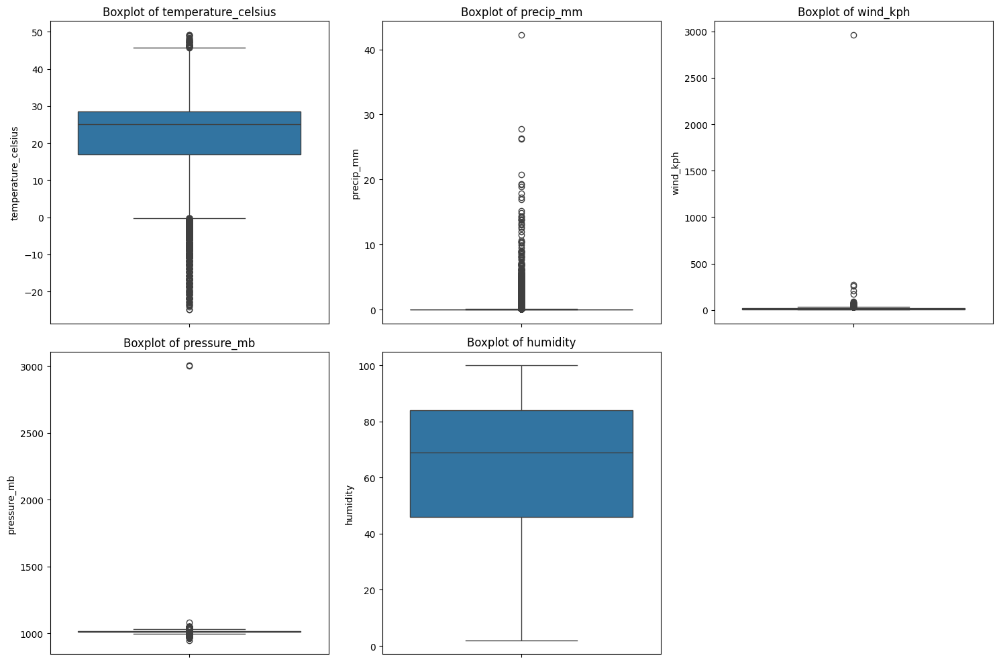

In [6]:
# Function to detect outliers using IQR method
def detect_outliers(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outliers = df[(df[column] < lower_bound) | (df[column] > upper_bound)][column]
    return outliers, lower_bound, upper_bound

# Analyze outliers in temperature and precipitation
columns_to_check = ['temperature_celsius', 'precip_mm', 'wind_kph', 'pressure_mb', 'humidity']

# Create plots to visualize outliers
plt.figure(figsize=(15, 10))

for idx, column in enumerate(columns_to_check, 1):
    plt.subplot(2, 3, idx)
    outliers, lower, upper = detect_outliers(df, column)
    
    # Create box plot
    sns.boxplot(y=df[column])
    plt.title(f'Boxplot of {column}')
    
    # Print outlier statistics
    print(f"\nOutlier Analysis for {column}:")
    print("-" * 50)
    print(f"Number of outliers: {len(outliers)}")
    print(f"Percentage of outliers: {(len(outliers)/len(df))*100:.2f}%")
    print(f"Lower bound: {lower:.2f}")
    print(f"Upper bound: {upper:.2f}")
    print(f"Min value: {df[column].min():.2f}")
    print(f"Max value: {df[column].max():.2f}")

plt.tight_layout()
plt.show()




In [7]:
# 3. Handle outliers using capping method
def handle_outliers(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    
    df_clean = df.copy()
    df_clean[column] = df_clean[column].clip(lower=lower_bound, upper=upper_bound)
    return df_clean

# Create a new dataframe with handled outliers
df_cleaned = df.copy()
for column in columns_to_check:
    df_cleaned = handle_outliers(df_cleaned, column)

# 4. Normalize the data using StandardScaler
from sklearn.preprocessing import StandardScaler

# Select numerical columns for normalization
numerical_columns = df_cleaned.select_dtypes(include=['float64', 'int64']).columns

# Create a scaler object
scaler = StandardScaler()

# Fit and transform the data
df_normalized = df_cleaned.copy()
df_normalized[numerical_columns] = scaler.fit_transform(df_cleaned[numerical_columns])

# Compare original and normalized distributions
plt.figure(figsize=(15, 10))


<Figure size 1500x1000 with 0 Axes>

<Figure size 1500x1000 with 0 Axes>

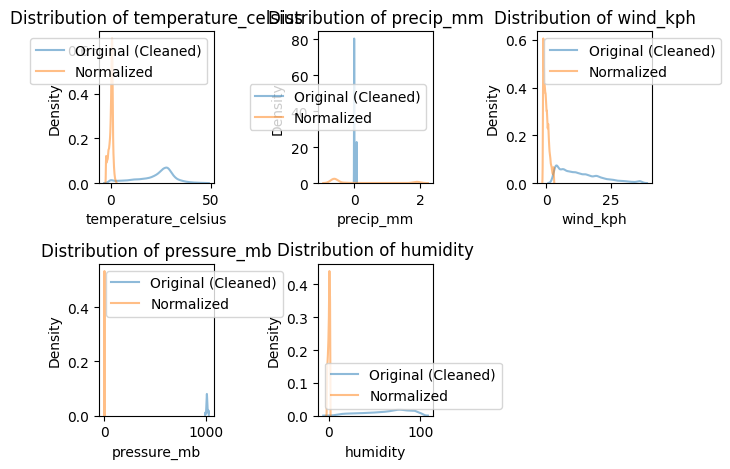


Summary Statistics of Normalized Data:
--------------------------------------------------


,temperature_celsius,precip_mm,wind_kph,pressure_mb,humidity
count,5.827000e+04,5.827000e+04,5.827000e+04,5.827000e+04,5.827000e+04
mean,-1.990056e-16,-1.288903e-16,3.414312e-18,-4.185947e-15,6.340865e-17
std,1.000009e+00,1.000009e+00,1.000009e+00,1.000009e+00,1.000009e+00
min,-2.419154e+00,-6.048817e-01,-1.168429e+00,-2.402985e+00,-2.524263e+00
25%,-5.709159e-01,-6.048817e-01,-8.147662e-01,-6.077686e-01,-7.240846e-01
50%,2.862378e-01,-6.048817e-01,-2.415886e-01,-1.589646e-01,2.169176e-01
75%,6.612425e-01,4.000496e-01,6.364708e-01,5.890421e-01,8.306146e-01
max,2.509480e+00,1.907446e+00,2.813326e+00,2.384258e+00,1.485225e+00


In [8]:
for idx, column in enumerate(columns_to_check, 1):
    plt.subplot(2, 3, idx)
    
    # Plot original vs normalized distributions
    sns.kdeplot(data=df_cleaned[column], label='Original (Cleaned)', alpha=0.5)
    sns.kdeplot(data=df_normalized[column], label='Normalized', alpha=0.5)
    
    plt.title(f'Distribution of {column}')
    plt.legend()

plt.tight_layout()
plt.show()

# Display summary statistics of normalized data
print("\nSummary Statistics of Normalized Data:")
print("-" * 50)
display(df_normalized[columns_to_check].describe())

# Save the cleaned and normalized dataframes
df_cleaned.to_csv('cleaned_weather_data.csv', index=False)
df_normalized.to_csv('normalized_weather_data.csv', index=False)

## Processed Data

In [9]:
new_file = pd.read_csv("normalized_weather_data.csv")
new_file.head()

,country,location_name,latitude,longitude,timezone,last_updated_epoch,last_updated,temperature_celsius,temperature_fahrenheit,condition_text,...,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,air_quality_gb-defra-index,sunrise,sunset,moonrise,moonset,moon_phase,moon_illumination
0,Afghanistan,Kabul,0.628514,0.714089,Asia/Kabul,-1.724566,2024-05-16 13:15,0.457669,0.449186,Partly Cloudy,...,-0.377674,-0.154125,-0.726393,-0.653938,04:50 AM,06:50 PM,12:12 PM,01:11 AM,Waxing Gibbous,0.171654
1,Albania,Tirana,0.906738,-0.035934,Europe/Tirane,-1.724566,2024-05-16 10:45,-0.356628,-0.335274,Partly cloudy,...,-0.539956,-0.310118,-0.726393,-0.653938,05:21 AM,07:54 PM,12:58 PM,02:14 AM,Waxing Gibbous,0.171654
2,Algeria,Algiers,0.720030,-0.290753,Africa/Algiers,-1.724566,2024-05-16 09:45,0.071949,0.080028,Sunny,...,-0.333213,-0.206123,-0.726393,-0.653938,05:40 AM,07:50 PM,01:15 PM,02:14 AM,Waxing Gibbous,0.171654
3,Andorra,Andorra La Vella,0.954538,-0.314001,Europe/Andorra,-1.724566,2024-05-16 10:45,-1.717359,-1.656167,Light drizzle,...,-0.548848,-0.317094,-0.726393,-0.653938,06:31 AM,09:11 PM,02:12 PM,03:31 AM,Waxing Gibbous,0.171654
4,Angola,Luanda,-1.142966,-0.136068,Africa/Luanda,-1.724566,2024-05-16 09:45,0.393382,0.391505,Partly cloudy,...,3.512649,1.340489,3.302634,2.817724,06:12 AM,05:55 PM,01:17 PM,12:38 AM,Waxing Gibbous,0.171654


-----------------

# EDA
## At this stage, IQR method is implemented to detect and identify the outliers. More analysis will be documented in the report. 

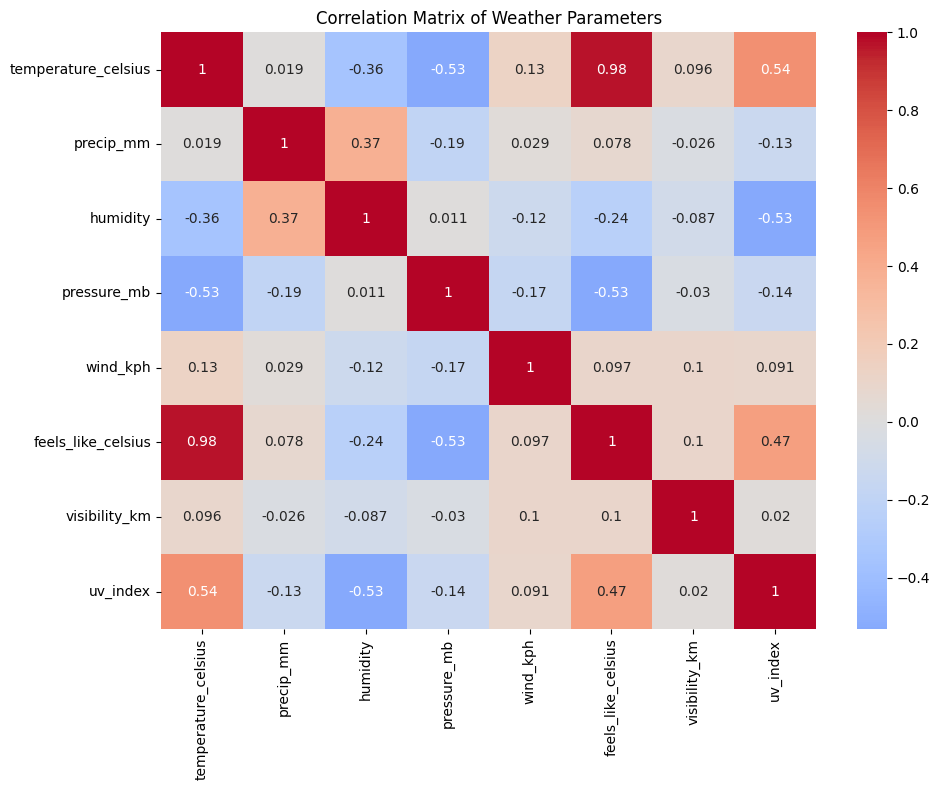

In [54]:
plt.figure(figsize=(10, 8))
# Select relevant numerical columns for correlation analysis
numerical_cols = ['temperature_celsius', 'precip_mm', 'humidity', 'pressure_mb', 
                 'wind_kph', 'feels_like_celsius', 'visibility_km', 'uv_index']

correlation_matrix = new_file[numerical_cols].corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0)
plt.title('Correlation Matrix of Weather Parameters')
plt.tight_layout()
plt.show()

### Visualizations for temperature.

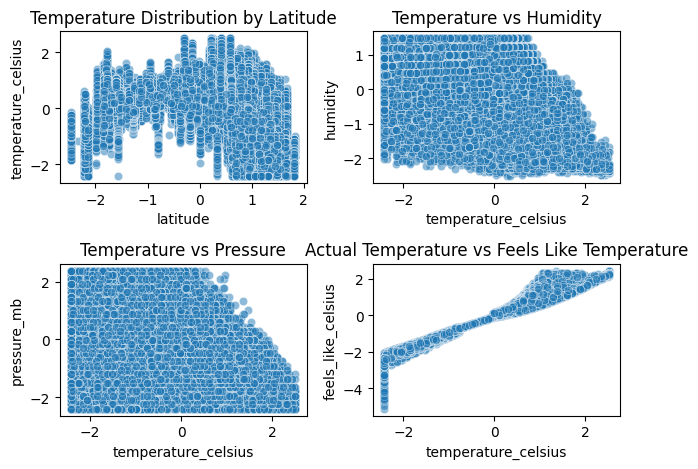

In [11]:
# Temperature distribution by latitude
plt.subplot(2, 2, 1)
sns.scatterplot(data=new_file, x='latitude', y='temperature_celsius', alpha=0.5)
plt.title('Temperature Distribution by Latitude')

# Temperature vs Humidity
plt.subplot(2, 2, 2)
sns.scatterplot(data=new_file, x='temperature_celsius', y='humidity', alpha=0.5)
plt.title('Temperature vs Humidity')

# Temperature vs Pressure
plt.subplot(2, 2, 3)
sns.scatterplot(data=new_file, x='temperature_celsius', y='pressure_mb', alpha=0.5)
plt.title('Temperature vs Pressure')

# Temperature vs Feels Like
plt.subplot(2, 2, 4)
sns.scatterplot(data=new_file, x='temperature_celsius', y='feels_like_celsius', alpha=0.5)
plt.title('Actual Temperature vs Feels Like Temperature')

plt.tight_layout()
plt.show()

In [12]:
fig = px.scatter(new_file, 
                 x='latitude', 
                 y='temperature_celsius',
                 color='temperature_celsius',
                 hover_data=['country', 'location_name'],
                 title='Interactive Temperature Distribution by Latitude',
                 color_continuous_scale='RdBu_r')
fig.show()

In [13]:
if 'last_updated' in new_file.columns:
    new_file['last_updated'] = pd.to_datetime(new_file['last_updated'])
    fig = px.line(new_file.groupby('last_updated')['temperature_celsius'].mean().reset_index(),
                  x='last_updated',
                  y='temperature_celsius',
                  title='Temperature Trend Over Time')
    fig.show()

## Visualizations for the precipitation

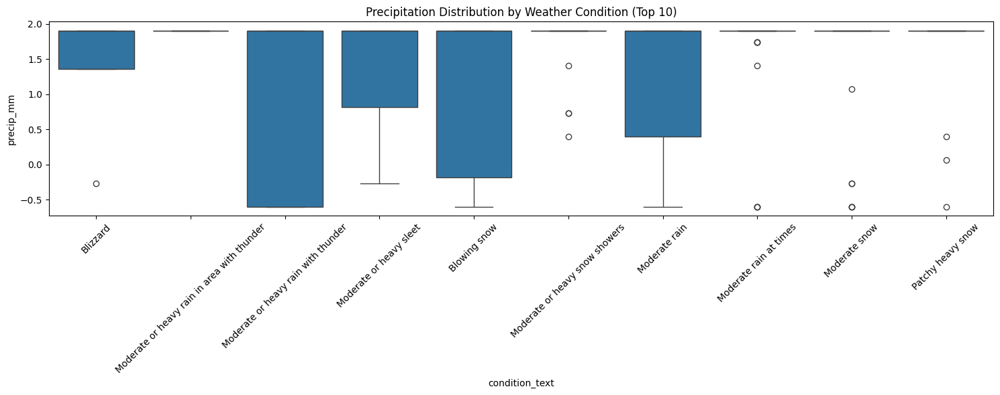

In [14]:
plt.figure(figsize=(15, 6))
sns.boxplot(data=new_file, x='condition_text', y='precip_mm',
            order=new_file.groupby('condition_text')['precip_mm'].median().sort_values(ascending=False).head(10).index)
plt.xticks(rotation=45)
plt.title('Precipitation Distribution by Weather Condition (Top 10)')
plt.tight_layout()
plt.show()

In [15]:
correlation_vars = ['precip_mm', 'humidity', 'pressure_mb', 'wind_kph', 
                   'temperature_celsius', 'visibility_km', 'cloud']
correlation_matrix = new_file[correlation_vars].corr()

fig = go.Figure(data=go.Heatmap(
                z=correlation_matrix,
                x=correlation_vars,
                y=correlation_vars,
                colorscale='RdBu',
                zmin=-1, zmax=1))
fig.update_layout(title='Correlation Matrix with Precipitation',
                 width=800, height=800)
fig.show()

## Model Building

In [16]:
from datetime import datetime, timedelta
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from tensorflow.keras.optimizers import Adam
from statsmodels.tsa.statespace.sarimax import SARIMAX


In [17]:
new_file['last_updated'] = pd.to_datetime(new_file['last_updated'])
new_file = new_file.sort_values('last_updated')

In [18]:
new_file

,country,location_name,latitude,longitude,timezone,last_updated_epoch,last_updated,temperature_celsius,temperature_fahrenheit,condition_text,...,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,air_quality_gb-defra-index,sunrise,sunset,moonrise,moonset,moon_phase,moon_illumination
186,United States of America,Washington Park,1.122045,-2.167936,America/Los_Angeles,-1.724566,2024-05-16 01:45:00,-0.667346,-0.635215,Clear,...,-0.424358,-0.277778,-0.726393,-0.653938,05:26 AM,08:31 PM,01:36 PM,02:52 AM,Waxing Gibbous,0.171654
110,Mexico,Mexico City,0.012010,-1.843372,America/Mexico_City,-1.724566,2024-05-16 02:45:00,-0.163768,-0.150695,Clear,...,0.215878,-0.018424,0.280863,0.117543,06:01 AM,07:05 PM,01:37 PM,01:49 AM,Waxing Gibbous,0.171654
74,Honduras,Tegucigalpa,-0.205748,-1.662400,America/Tegucigalpa,-1.724566,2024-05-16 02:45:00,0.071949,0.080028,Partly cloudy,...,-0.142032,-0.162369,0.280863,-0.268198,05:22 AM,06:09 PM,12:52 PM,12:55 AM,Waxing Gibbous,0.171654
68,Guatemala,Guatemala City,-0.184503,-1.712695,America/Guatemala,-1.724566,2024-05-16 02:45:00,-0.249483,-0.231448,Mist,...,2.370005,0.806563,2.295377,2.817724,05:34 AM,06:23 PM,01:05 PM,01:09 AM,Waxing Gibbous,0.171654
40,Costa Rica,San Juan,-0.374480,-1.614688,America/Costa_Rica,-1.724566,2024-05-16 02:45:00,-0.142339,-0.127623,Fog,...,-0.082010,-0.175051,0.280863,-0.268198,05:15 AM,05:51 PM,12:42 PM,12:37 AM,Waxing Gibbous,0.171654
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58182,Marshall Islands,Majuro,-0.491734,2.267062,Pacific/Majuro,1.718324,2025-03-12 21:45:00,0.532669,0.524171,Overcast,...,-0.391679,-0.241856,-0.726393,-0.653938,06:42 AM,06:46 PM,05:14 PM,05:07 AM,Waxing Gibbous,1.260957
58256,Tuvalu,Funafuti,-1.129757,2.386090,Pacific/Funafuti,1.718324,2025-03-12 21:45:00,0.618385,0.616461,Partly cloudy,...,-0.457481,-0.273530,-0.726393,-0.653938,06:07 AM,06:18 PM,04:58 PM,04:14 AM,Waxing Gibbous,1.260957
58223,Samoa,Apia,-1.346968,-2.946575,Pacific/Apia,1.718324,2025-03-12 22:45:00,0.307667,0.310752,Partly cloudy,...,-0.519282,-0.302414,-0.726393,-0.653938,06:30 AM,06:43 PM,05:27 PM,04:30 AM,Waxing Gibbous,1.232291
58198,New Zealand,Wellington,-2.469124,2.318724,Pacific/Auckland,1.718324,2025-03-12 22:45:00,-0.988778,-0.946692,Partly cloudy,...,-0.449256,-0.279395,-0.726393,-0.653938,07:15 AM,07:47 PM,07:01 PM,04:38 AM,Waxing Gibbous,1.232291


In [19]:
new_file['hour'] = new_file['last_updated'].dt.hour
new_file['day'] = new_file['last_updated'].dt.day
new_file['month'] = new_file['last_updated'].dt.month
new_file['dayofweek'] = new_file['last_updated'].dt.dayofweek
new_file['week'] = new_file['last_updated'].dt.isocalendar().week
new_file['year'] = new_file['last_updated'].dt.year


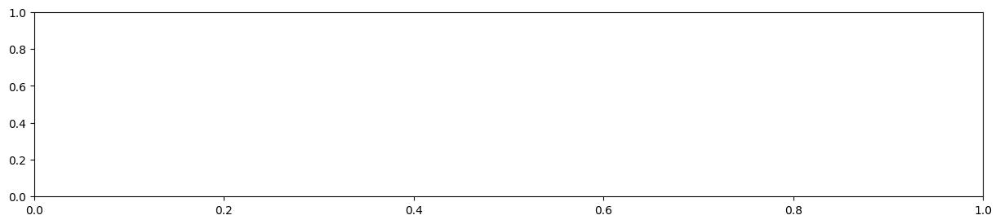

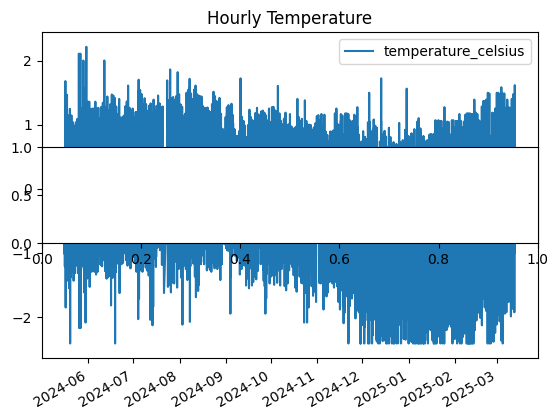

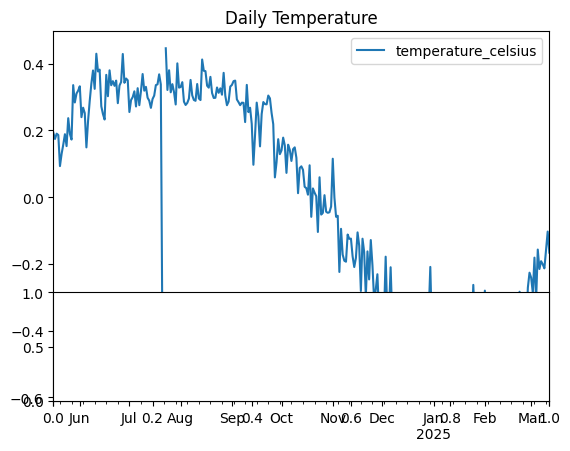

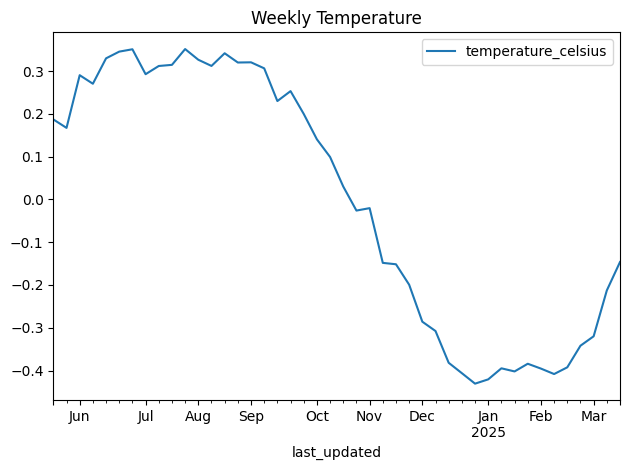

In [20]:
# 2. Analyze Time Series Patterns
# Group by timestamp and calculate mean temperature
hourly_temp = new_file.groupby('last_updated')['temperature_celsius'].mean().reset_index()
hourly_temp.set_index('last_updated', inplace=True)

# Resample data to different time frequencies
daily_temp = hourly_temp.resample('D').mean()
weekly_temp = hourly_temp.resample('W').mean()

# Plot time series at different frequencies
plt.figure(figsize=(15, 10))
plt.subplot(311)
hourly_temp.plot()
plt.title('Hourly Temperature')
plt.xlabel('')
plt.subplot(312)
daily_temp.plot()
plt.title('Daily Temperature')
plt.xlabel('')

plt.subplot(313)
weekly_temp.plot()
plt.title('Weekly Temperature')

plt.tight_layout()
plt.show()

#### First Model --- LSTM model

In [21]:
def create_sequences(data, seq_length):
    X, y = [], []
    for i in range(len(data) - seq_length):
        X.append(data[i:(i + seq_length)])
        y.append(data[i + seq_length])
    return np.array(X), np.array(y)

# Prepare data for LSTM
sequence_length = 24  # Use 24 hours of data to predict next hour

# Create feature matrix
features_df = pd.DataFrame({
    'temperature': hourly_temp['temperature_celsius'],
    'hour': hourly_temp.index.hour,
    'day': hourly_temp.index.day,
    'month': hourly_temp.index.month,
    'dayofweek': hourly_temp.index.dayofweek
})

# Scale features
scaler = MinMaxScaler()
scaled_features = scaler.fit_transform(features_df)
scaled_features_df = pd.DataFrame(scaled_features, columns=features_df.columns)

# Create sequences
X, y = create_sequences(scaled_features, sequence_length)


In [22]:
# Split data
train_size = int(len(X) * 0.8)
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]

# Build LSTM model
model_lstm = Sequential([
    LSTM(50, activation='relu', input_shape=(sequence_length, X.shape[2]), return_sequences=True),
    Dropout(0.2),
    LSTM(50, activation='relu'),
    Dropout(0.2),
    Dense(y.shape[1])
])

model_lstm.compile(optimizer=Adam(learning_rate=0.001), loss='mse')

# Train LSTM model
history = model_lstm.fit(X_train, y_train,
                        epochs=50,
                        batch_size=32,
                        validation_split=0.1,
                        verbose=1)

Epoch 1/50


2025-03-13 18:51:25.115869: W tensorflow/tsl/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


219/219 [==============================] - 3s 11ms/step - loss: 0.0653 - val_loss: 0.0405
Epoch 2/50
219/219 [==============================] - 2s 11ms/step - loss: 0.0278 - val_loss: 0.0406
Epoch 3/50
219/219 [==============================] - 3s 13ms/step - loss: 0.0225 - val_loss: 0.0393
Epoch 4/50
219/219 [==============================] - 2s 10ms/step - loss: 0.0205 - val_loss: 0.0392
Epoch 5/50
219/219 [==============================] - 2s 10ms/step - loss: 0.0190 - val_loss: 0.0356
Epoch 6/50
219/219 [==============================] - 2s 10ms/step - loss: 0.0179 - val_loss: 0.0385
Epoch 7/50
219/219 [==============================] - 2s 11ms/step - loss: 0.0173 - val_loss: 0.0382
Epoch 8/50
219/219 [==============================] - 2s 10ms/step - loss: 0.0164 - val_loss: 0.0382
Epoch 9/50
219/219 [==============================] - 2s 10ms/step - loss: 0.0157 - val_loss: 0.0374
Epoch 10/50
219/219 [==============================] - 2s 10ms/step - loss: 0.0151 - val_loss: 0.0339


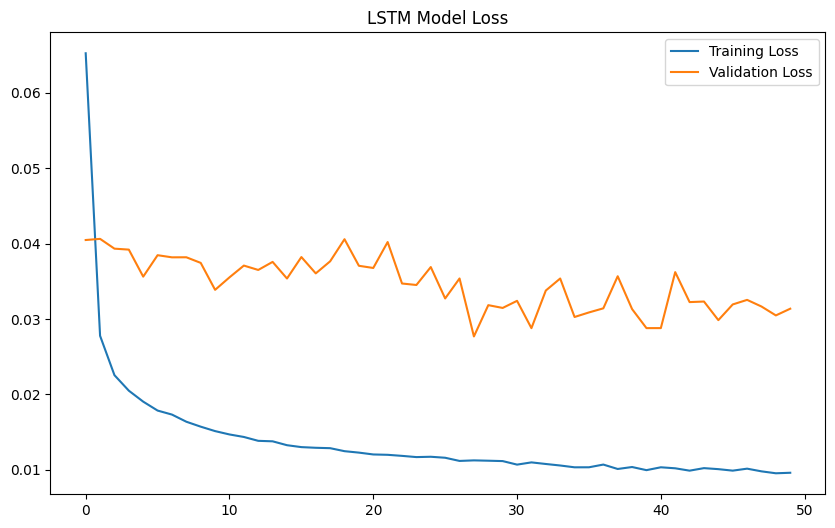

In [23]:
# Plot LSTM training history
plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('LSTM Model Loss')
plt.legend()
plt.show()

In [24]:
# Make predictions
y_pred_lstm_raw = model_lstm.predict(X_test)

# Inverse transform predictions
y_pred_lstm_inverse = scaler.inverse_transform(y_pred_lstm_raw)[:, 0]
y_test_inverse = scaler.inverse_transform(y_test)[:, 0]

# 6. Model Evaluation
print("\nModel Evaluation:")
print("-" * 50)

61/61 [==============================] - 0s 2ms/step

Model Evaluation:
--------------------------------------------------


In [25]:
def calculate_metrics(y_true, y_pred, model_name):
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    
    print(f"{model_name} Metrics:")
    print(f"RMSE: {rmse:.2f}")
    print(f"MAE: {mae:.2f}")
    print(f"R2 Score: {r2:.2f}\n")

In [27]:
calculate_metrics(y_test_inverse, y_pred_lstm_inverse, "LSTM")

LSTM Metrics:
RMSE: 0.98
MAE: 0.72
R2 Score: -0.38



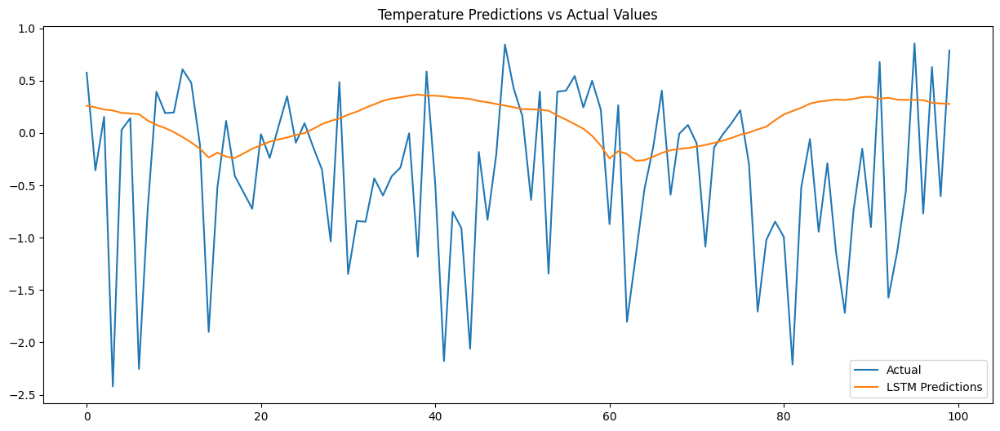

In [29]:
plt.figure(figsize=(15, 6))
plt.plot(y_test_inverse[:100], label='Actual')
plt.plot(y_pred_lstm_inverse[:100], label='LSTM Predictions')
plt.title('Temperature Predictions vs Actual Values')
plt.legend()
plt.show()

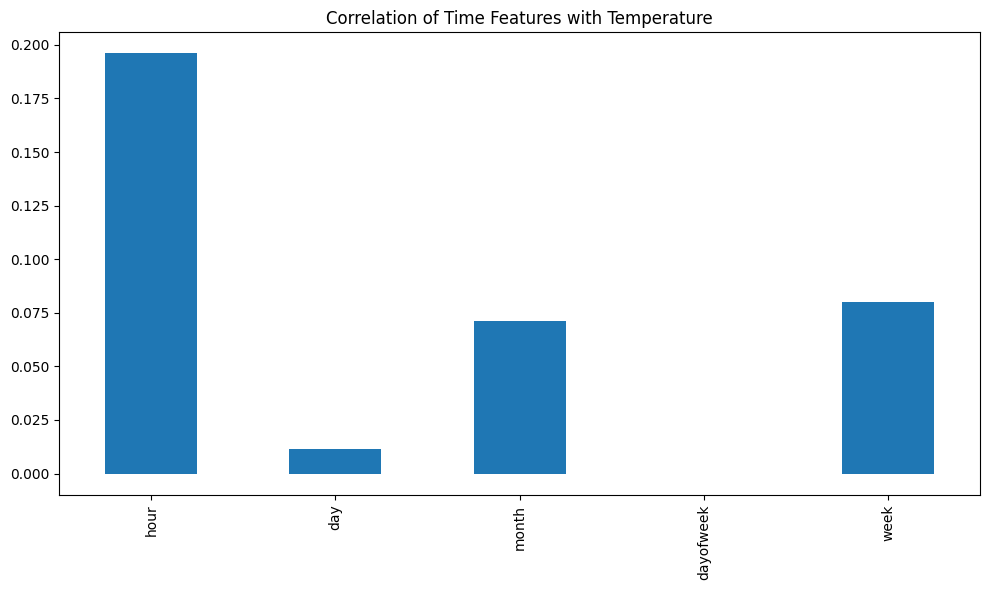

In [30]:
time_features = ['hour', 'day', 'month', 'dayofweek', 'week']
correlation_matrix = new_file[['temperature_celsius'] + time_features].corr()['temperature_celsius']

plt.figure(figsize=(10, 6))
correlation_matrix[1:].plot(kind='bar')
plt.title('Correlation of Time Features with Temperature')
plt.tight_layout()
plt.show()

#### Second Model --- Simple linear model

In [31]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

In [32]:
def prepare_lr_features(df):
    lr_features = df.copy()
    
    # time feature
    lr_features['hour'] = lr_features['last_updated'].dt.hour
    lr_features['day'] = lr_features['last_updated'].dt.day
    lr_features['month'] = lr_features['last_updated'].dt.month
    lr_features['dayofweek'] = lr_features['last_updated'].dt.dayofweek
    
    # feature selection
    feature_cols = ['hour', 'day', 'month', 'dayofweek', 
                   'humidity', 'pressure_mb', 'wind_kph']
    
    return lr_features[feature_cols]

In [33]:
X_lr = prepare_lr_features(new_file)
y_lr = new_file['temperature_celsius']

# Split data
X_train_lr, X_test_lr, y_train_lr, y_test_lr = train_test_split(X_lr, y_lr, test_size=0.2, random_state=42)

# 2. train model
lr_model = LinearRegression()
lr_model.fit(X_train_lr, y_train_lr)
lr_predictions = lr_model.predict(X_test_lr)

In [34]:
def evaluate_models(y_true_lstm, y_pred_lstm, y_true_lr, y_pred_lr):
    results = []
    
    # LSTM evaluation
    lstm_metrics = {
        'Model': 'LSTM',
        'RMSE': np.sqrt(mean_squared_error(y_true_lstm, y_pred_lstm)),
        'MAE': mean_absolute_error(y_true_lstm, y_pred_lstm),
        'R2': r2_score(y_true_lstm, y_pred_lstm)
    }
    results.append(lstm_metrics)
    
    # Linear Regression Evaluation
    lr_metrics = {
        'Model': 'Linear Regression',
        'RMSE': np.sqrt(mean_squared_error(y_true_lr, y_pred_lr)),
        'MAE': mean_absolute_error(y_true_lr, y_pred_lr),
        'R2': r2_score(y_true_lr, y_pred_lr)
    }
    results.append(lr_metrics)
    
    return pd.DataFrame(results)

In [37]:
results_df = evaluate_models(y_test, y_pred_lstm_raw, y_test_lr, lr_predictions)
print("\nModel Compare：")
print("-" * 50)
display(results_df)


Model Compare：
--------------------------------------------------


,Model,RMSE,MAE,R2
0,LSTM,0.145841,0.102269,-0.800956
1,Linear Regression,0.774873,0.598831,0.408313


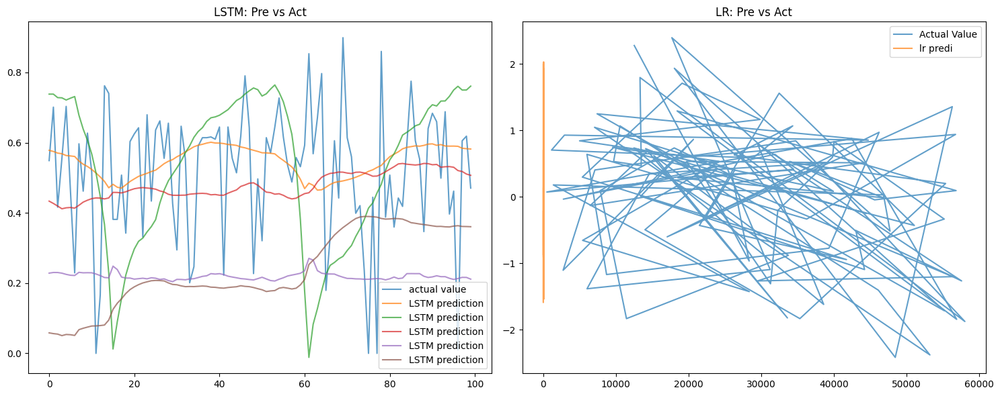

In [55]:
plt.figure(figsize=(15, 6))
plt.subplot(1, 2, 1)
plt.plot(y_test[:100], label='actual value', alpha=0.7)
plt.plot(y_pred_lstm_raw[:100], label='LSTM prediction', alpha=0.7)
plt.title('LSTM: Pre vs Act')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(y_test_lr[:100], label='Actual Value', alpha=0.7)
plt.plot(lr_predictions[:100], label='lr predi', alpha=0.7)
plt.title('LR: Pre vs Act')
plt.legend()

plt.tight_layout()
plt.show()

## Ensemble model

For this model, what I implemented is the LSTM and the random Forest regression model.


In [43]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import MinMaxScaler


In [44]:
def prepare_rf_features(df):
    rf_features = df.copy()
    
    
    rf_features['hour'] = rf_features['last_updated'].dt.hour
    rf_features['day'] = rf_features['last_updated'].dt.day
    rf_features['month'] = rf_features['last_updated'].dt.month
    rf_features['dayofweek'] = rf_features['last_updated'].dt.dayofweek
    
    
    for lag in [1, 2, 3, 6, 12, 24]:
        rf_features[f'temp_lag_{lag}'] = rf_features['temperature_celsius'].shift(lag)
    
    
    feature_cols = ['hour', 'day', 'month', 'dayofweek', 
                    'humidity', 'pressure_mb', 'wind_kph'] + \
                   [col for col in rf_features.columns if 'lag_' in col]
    
    return rf_features[feature_cols].dropna()

In [45]:
X_rf = prepare_rf_features(new_file)
y_rf = new_file.loc[X_rf.index, 'temperature_celsius']  # Align indices

# Split data
X_train_rf, X_test_rf, y_train_rf, y_test_rf = train_test_split(
    X_rf, y_rf, test_size=0.2, random_state=42
)

# 3. Train RF
print("训练随机森林模型...")
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X_train_rf, y_train_rf)

# 4. Prediction
rf_predictions = rf_model.predict(X_test_rf)

训练随机森林模型...


In [46]:
# 5. 
def ensemble_predict(y_pred_lstm, y_pred_rf, weights=[0.8, 0.2]):
    return weights[0] * y_pred_lstm + weights[1] * y_pred_rf


In [47]:
y_pred_lstm_flat = y_pred_lstm_inverse.flatten()  # Ensure it's 1D

# **Align lengths of predictions**
min_length = min(len(y_pred_lstm_flat), len(rf_predictions))
y_pred_lstm_flat = y_pred_lstm_flat[:min_length]
rf_predictions = rf_predictions[:min_length]
y_test_aligned = y_test_inverse[:min_length]  # Align y_test

ensemble_predictions = ensemble_predict(y_pred_lstm_flat, rf_predictions)

In [48]:
def ensemble_predict(y_pred_lstm, y_pred_rf, weights=[0.5, 0.5]):
    return weights[0] * y_pred_lstm + weights[1] * y_pred_rf

# 6. process LSTM
y_pred_lstm_flat = y_pred_lstm_inverse.flatten()  # Ensure it's 1D

# **Align lengths of predictions**
min_length = min(len(y_pred_lstm_flat), len(rf_predictions))
y_pred_lstm_flat = y_pred_lstm_flat[:min_length]
rf_predictions = rf_predictions[:min_length]
y_test_aligned = y_test_inverse[:min_length]  # Align y_test

# 7. Ensemble prediction
ensemble_predictions = ensemble_predict(y_pred_lstm_flat, rf_predictions)

# 8. Evaluate model
def evaluate_ensemble(y_test, y_pred_lstm, y_pred_rf, ensemble_pred):
    results = []
    
    # LSTM 
    lstm_metrics = {
        'Model': 'LSTM',
        'RMSE': np.sqrt(mean_squared_error(y_test, y_pred_lstm)),
        'MAE': mean_absolute_error(y_test, y_pred_lstm),
        'R2': r2_score(y_test, y_pred_lstm)
    }
    results.append(lstm_metrics)
    
    # RF
    rf_metrics = {
        'Model': 'Random Forest',
        'RMSE': np.sqrt(mean_squared_error(y_test, y_pred_rf)),
        'MAE': mean_absolute_error(y_test, y_pred_rf),
        'R2': r2_score(y_test, y_pred_rf)
    }
    results.append(rf_metrics)

    
    ensemble_metrics = {
        'Model': 'Ensemble',
        'RMSE': np.sqrt(mean_squared_error(y_test, ensemble_pred)),
        'MAE': mean_absolute_error(y_test, ensemble_pred),
        'R2': r2_score(y_test, ensemble_pred)
    }
    results.append(ensemble_metrics)
    
    return pd.DataFrame(results)

In [49]:
results_df1 = evaluate_ensemble(y_test_aligned, y_pred_lstm_flat, rf_predictions, ensemble_predictions)
display(results_df1)


,Model,RMSE,MAE,R2
0,LSTM,0.982621,0.721045,-0.381863
1,Random Forest,1.227973,0.973498,-1.158096
2,Ensemble,1.022875,0.785267,-0.497402


## LSTM and Transformers

Epoch 1/50
1311/1311 [==============================] - 16s 11ms/step - loss: 0.0569 - val_loss: 0.0337
Epoch 2/50
1311/1311 [==============================] - 14s 11ms/step - loss: 0.0363 - val_loss: 0.0351
Epoch 3/50
1311/1311 [==============================] - 14s 10ms/step - loss: 0.0345 - val_loss: 0.0322
Epoch 4/50
1311/1311 [==============================] - 13s 10ms/step - loss: 0.0339 - val_loss: 0.0336
Epoch 5/50
1311/1311 [==============================] - 14s 10ms/step - loss: 0.0335 - val_loss: 0.0313
Epoch 6/50
1311/1311 [==============================] - 14s 10ms/step - loss: 0.0331 - val_loss: 0.0311
Epoch 7/50
1311/1311 [==============================] - 14s 11ms/step - loss: 0.0330 - val_loss: 0.0317
Epoch 8/50
1311/1311 [==============================] - 14s 11ms/step - loss: 0.0329 - val_loss: 0.0311
Epoch 9/50
1311/1311 [==============================] - 14s 10ms/step - loss: 0.0327 - val_loss: 0.0306
Epoch 10/50
1311/1311 [==============================] - 14s 11m

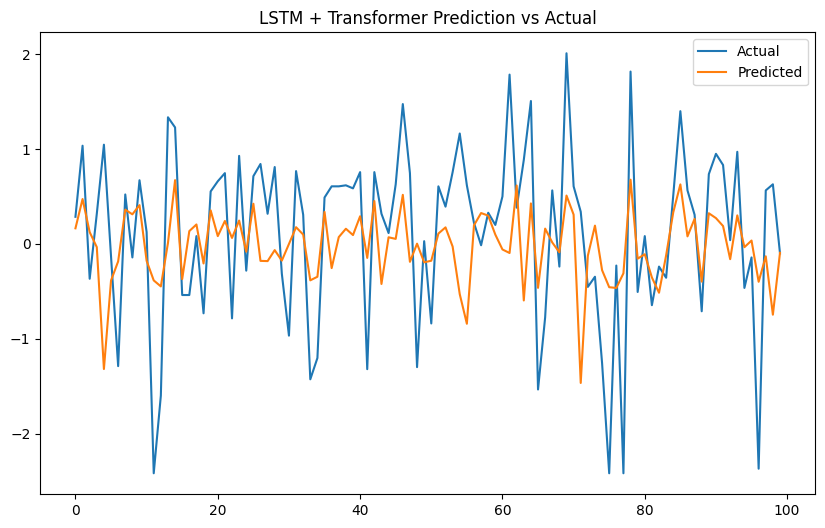

In [50]:
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, LSTM, Dense, Dropout, LayerNormalization, MultiHeadAttention, Flatten, Concatenate
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

# ===============================
# 1. preprocess
# ===============================

new_file['last_updated'] = pd.to_datetime(new_file['last_updated'])
new_file = new_file.sort_values('last_updated')

new_file['hour'] = new_file['last_updated'].dt.hour
new_file['day'] = new_file['last_updated'].dt.day
new_file['month'] = new_file['last_updated'].dt.month
new_file['dayofweek'] = new_file['last_updated'].dt.dayofweek

feature_cols = ['temperature_celsius', 'hour', 'day', 'month', 'dayofweek', 'humidity', 'pressure_mb', 'wind_kph']

# scaler
scaler = MinMaxScaler()
scaled_features = scaler.fit_transform(new_file[feature_cols])

# time sequence
sequence_length = 24 
X, y = [], []
for i in range(len(scaled_features) - sequence_length):
    X.append(scaled_features[i:i + sequence_length])
    y.append(scaled_features[i + sequence_length][0])  # 预测 temperature_celsius

X = np.array(X)
y = np.array(y)


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

sequence_length, feature_dim = X_train.shape[1], X_train.shape[2]

# ===============================
# 2. LSTM 
# ===============================
def build_lstm_layer(input_shape):
    lstm_input = Input(shape=input_shape)
    lstm_out = LSTM(64, return_sequences=True, activation='relu')(lstm_input)
    lstm_out = LSTM(32, return_sequences=False, activation='relu')(lstm_out)  # 最后一个 LSTM 只返回最终状态
    return Model(lstm_input, lstm_out, name="LSTM_Module")

# ===============================
# 3. Transformer 
# ===============================
def build_transformer_layer(input_shape, num_heads=4, ff_dim=64):
    transformer_input = Input(shape=input_shape)
    

    attn_output = MultiHeadAttention(num_heads=num_heads, key_dim=ff_dim)(transformer_input, transformer_input)
    attn_output = Dropout(0.1)(attn_output)
    attn_output = LayerNormalization(epsilon=1e-6)(attn_output + transformer_input)  # 残差连接


    ffn_output = Dense(ff_dim, activation="relu")(attn_output)
    ffn_output = Dense(input_shape[-1])(ffn_output)
    ffn_output = Dropout(0.1)(ffn_output)
    transformer_output = LayerNormalization(epsilon=1e-6)(ffn_output + attn_output)  # 残差连接

    transformer_output = Flatten()(transformer_output)
    
    return Model(transformer_input, transformer_output, name="Transformer_Module")

# ===============================
# 4. final model
# ===============================

# input layer
model_input = Input(shape=(sequence_length, feature_dim))

# LSTM 
lstm_module = build_lstm_layer((sequence_length, feature_dim))
lstm_features = lstm_module(model_input)

# Transformer 
transformer_module = build_transformer_layer((sequence_length, feature_dim))
transformer_features = transformer_module(model_input)

# merge LSTM and Transformers
merged = Concatenate()([lstm_features, transformer_features])
merged = Dense(64, activation='relu')(merged)
merged = Dropout(0.2)(merged)
merged = Dense(32, activation='relu')(merged)
merged = Dropout(0.2)(merged)


output = Dense(1)(merged)

# model
final_model = Model(inputs=model_input, outputs=output)
final_model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001), loss='mse')

# ===============================
# 5. train model
# ===============================
history = final_model.fit(X_train, y_train, 
                          epochs=50, 
                          batch_size=32, 
                          validation_split=0.1, 
                          verbose=1)

# ===============================
# 6. Viz
# ===============================
y_pred_transformer_lstm = final_model.predict(X_test)

# 
y_pred_transformer_lstm_inverse = scaler.inverse_transform(
    np.hstack((y_pred_transformer_lstm, np.zeros((y_pred_transformer_lstm.shape[0], feature_dim - 1))))
)[:, 0]

y_test_inverse = scaler.inverse_transform(
    np.hstack((y_test.reshape(-1, 1), np.zeros((y_test.shape[0], feature_dim - 1))))
)[:, 0]

# pre vs actual
plt.figure(figsize=(10, 6))
plt.plot(y_test_inverse[:100], label='Actual')
plt.plot(y_pred_transformer_lstm_inverse[:100], label='Predicted')
plt.legend()
plt.title('LSTM + Transformer Prediction vs Actual')
plt.show()

In [51]:
def evaluate_ensemble(y_test, y_pred_lstm):
    results = []
    
    # LSTM + Transformer evaluation
    lstm_transformer_metrics = {
        'Model': 'LSTM + Transformer',
        'RMSE': np.sqrt(mean_squared_error(y_test, y_pred_lstm)),
        'MAE': mean_absolute_error(y_test, y_pred_lstm),
        'R2': r2_score(y_test, y_pred_lstm)
    }
    results.append(lstm_transformer_metrics)
    return pd.DataFrame(results)

In [52]:
results_df = evaluate_ensemble(y_test[:len(y_pred_transformer_lstm)], 
                               y_pred_transformer_lstm.flatten()
                               )
display(results_df)

,Model,RMSE,MAE,R2
0,LSTM + Transformer,0.173976,0.139175,0.26079


In [53]:
RESULT = results_df1 
RESULT

,Model,RMSE,MAE,R2
0,LSTM,0.982621,0.721045,-0.381863
1,Random Forest,1.227973,0.973498,-1.158096
2,Ensemble,1.022875,0.785267,-0.497402
